Celeb-real/id27_0005.mp4 was deleted due to it only has one frame

In [1]:
import sys
if '../../' not in sys.path:
    sys.path.append('../../')
from Utils.FileOperation import *
from Config import rootDir

import numpy as np
from PIL import Image, ImageDraw
import time
import cv2
import matplotlib.pyplot as plt
from collections import Counter
from batch_face import RetinaFace
import statistics
import math
import json

In [2]:
def calculate_mean_frame_count(video_paths):
    frame_counts = []

    for path in video_paths:
        cap = cv2.VideoCapture(path)
        frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        if frame_count == 1:
            print(path)
        frame_counts.append(frame_count)
        cap.release()

    mean_frame_count = statistics.mean(frame_counts)
    median_frame_count = statistics.median(frame_counts)
    max_frame_count = max(frame_counts)
    min_frame_count = min(frame_counts)

    return mean_frame_count, median_frame_count, max_frame_count, min_frame_count, frame_counts

def get_frame_ranges(frame_counts, bar_width):
    frame_ranges = []
    for frame_count in frame_counts:
        frame_range = (frame_count // bar_width) * bar_width
        frame_ranges.append(frame_range)
    return frame_ranges

Mean frame count: 382.66383701188454
Median frame count: 355
Maximum frame count: 740
Minimum frame count: 145


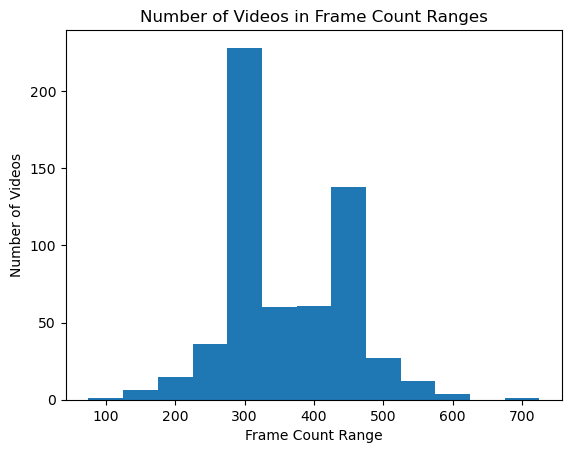

In [3]:
realDir = rootDir + 'CDF/Celeb-real/'
# Find length distribution of data
video_paths = [realDir + i for i in ls(realDir)]
mean_frames, median_frames, max_frames, min_frames, frame_counts = calculate_mean_frame_count(video_paths)
print(f"Mean frame count: {mean_frames}")
print(f"Median frame count: {median_frames}")
print(f"Maximum frame count: {max_frames}")
print(f"Minimum frame count: {min_frames}")

# Define the bar width for frame ranges
bar_width = 50

# Get the frame ranges for each video
frame_ranges = get_frame_ranges(frame_counts, bar_width)

# Count the number of videos in each frame range
frame_ranges_counter = Counter(frame_ranges)

# Prepare the data for plotting
x_values = list(frame_ranges_counter.keys())
y_values = list(frame_ranges_counter.values())

# Plotting the bar chart
plt.bar(x_values, y_values, width=bar_width)
plt.xlabel('Frame Count Range')
plt.ylabel('Number of Videos')
plt.title('Number of Videos in Frame Count Ranges')
plt.show()

In [4]:
aspect_ratio=1.0
def extract(
        detector,
        data_path,
        output_path,
        json_path=None,
        padding=0,
        smooth_level=0,
        batch_size=400
    ):
    '''
    Parameters:
        detector: RetinaFace detector (from batch_face import RetinaFace)
        data_path: path to video file
        output_path: path to output video file
        json_path: path to output json file if this variable is not None
        padding: number of pixels to pad the bounding box
        smooth_level: number of frames to smooth the bounding box
        batch_size: number of frames processed by detector at once
    '''

    troublesome = False

    original_video = cv2.VideoCapture(data_path)
    cnt = 0
    frames = []
    while original_video.isOpened():
        success, frame = original_video.read()
        if not success:
            break
        cnt += 1
        frames.append(frame)
    original_video.release()
    all_faces = []
    for i in range(math.ceil(len(frames)/batch_size)):
        all_faces.extend(detector(frames[i*batch_size:(i+1)*batch_size]))
    
    warned_zero = False
    h_max = 0
    all_boxes = []
    for face_info in all_faces:
        valid_bounding_boxes = []
        for box, landmarks, score in face_info:
            if score < .95:
                continue
            x_min = int(box[0])
            if x_min < 0:
                x_min = 0
            y_min=int(box[1])
            if y_min < 0:
                y_min = 0
            x_max = int(box[2])
            y_max = int(box[3])
            center = (int((x_min + x_max) // 2), int((y_min + y_max) // 2))
            bbox_width = x_max - x_min + 2 * padding
            bbox_height = max(y_max - y_min + 2 * padding, int(bbox_width * aspect_ratio))

            if bbox_height > h_max:
                h_max = bbox_height

            valid_bounding_boxes.append((center, bbox_height, score))

        if len(valid_bounding_boxes) == 0:
            if not warned_zero:
                warned_zero = True
                print('\n * Warning: 404 Faces Not Found at', len(all_boxes))
            all_boxes.append(None)
            continue
        
        elif len(valid_bounding_boxes) > 1:
            all_boxes.append(valid_bounding_boxes)
            continue

        all_boxes.append(valid_bounding_boxes[0][:2])
    
    # Find the mean bounding box center and height by averaging all valid bounding boxes that only have one face
    mean_center = [0, 0]
    mean_bbox_height = 0
    cnt = 0
    for i in range(len(all_boxes)):
        if all_boxes[i] is None or type(all_boxes[i]) is list:
            continue
        mean_center[0] += all_boxes[i][0][0]
        mean_center[1] += all_boxes[i][0][1]
        mean_bbox_height += all_boxes[i][1]
        cnt += 1
    if cnt != 0:
        mean_center[0] /= cnt
        mean_center[1] /= cnt
        mean_bbox_height /= cnt
    else:
        print("\n * Warning: 415 Found", len(all_boxes[0]), "Faces at 0. \n * When you see this message, it's probably because all frames have multiple faces")
        # Show the first frame with all bounding boxes
        frame = cv2.cvtColor(frames[0], cv2.COLOR_BGR2RGB)
        frame = Image.fromarray(frame)
        draw = ImageDraw.Draw(frame)
        for bbox in all_boxes[0]:
            draw.rectangle(get_bounding_box(bbox[0], bbox[1]), outline='red')
        frame.show()
        troublesome = True
        # This is probably because all frames have multiple faces
        # pick the biggest bounding box on the first frame as the mean bounding box
        for bbox in all_boxes[0]:
            if bbox[1] > mean_bbox_height:
                mean_bbox_height = bbox[1]
                mean_center = bbox[0]

    warned_multiple = False
    # Find the most appropriate bounding box for frames that have multiple faces by calculating IoU with mean bounding box
    for i in range(len(all_boxes)):
        if all_boxes[i] is None or type(all_boxes[i]) is tuple:
            continue
        best_bbox = None
        best_iou = 0
        for bbox in all_boxes[i]:
            iou = compute_iou(bbox, (mean_center, mean_bbox_height))
            if iou > best_iou:
                best_iou = iou
                best_bbox = bbox
        if best_bbox is None:
            # If no bounding box has IoU > 0, drop this frame
            if not warned_multiple:
                warned_multiple = True
                print('\n * Warning: 409 Found', len(all_boxes[i]), 'Faces at', i)
                troublesome = True
            # Draw all bounding boxes in red and mean bounding box in green on the frame and use PIL.Image to show it
            frame = cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB)
            frame = Image.fromarray(frame)
            draw = ImageDraw.Draw(frame)
            for bbox in all_boxes[i]:
                draw.rectangle(get_bounding_box(bbox[0], bbox[1]), outline='red')
            draw.rectangle(get_bounding_box(mean_center, mean_bbox_height), outline='green')
            frame.show()
            all_boxes[i] = None
            continue
        all_boxes[i] = best_bbox

    output_size = (int(h_max // aspect_ratio), h_max)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    if troublesome:
        output_path_elements = output_path.split('/')
        last_len = len(output_path_elements[-1])
        output_path_elements[-1] = 'troublesome/' + output_path_elements[-1]
        output_path = '/'.join(output_path_elements)
        mkdir(output_path[:-last_len])
    out = cv2.VideoWriter(output_path, fourcc, 30.0, output_size)
    calculated_boxes = []
    for i in range(len(frames)):
        if all_boxes[i] is None:
            calculated_boxes.append(None)
            continue
        frame = frames[i]
        id_0 = max(0, i - smooth_level // 2)
        id_1 = min(len(all_boxes), i + 1 + math.ceil(smooth_level / 2))
        center, bbox_height = smooth_frames(all_boxes[id_0:id_1], i - id_0)
        bbox = get_bounding_box(center, bbox_height)
        calculated_boxes.append(bbox)
        frame = Image.fromarray(frame).crop(bbox).resize(output_size)
        out.write(np.array(frame))
    out.release()

    assert len(calculated_boxes) == len(frames)

    # Save calculated_boxes as json file
    if json_path is not None:
        if troublesome:
            json_path_elements = json_path.split('/')
            last_len = len(json_path_elements[-1])
            json_path_elements[-1] = 'troublesome/' + json_path_elements[-1]
            json_path = '/'.join(json_path_elements)
            mkdir(json_path[:-last_len])
        with open(json_path, 'w') as f:
            json.dump(calculated_boxes, f)


def smooth_frames(bounding_boxes, target_index, iou_threshold=0.5):
    '''
    Smooth bounding boxes using linear interpolation
    Parameters:
        bounding_boxes: List of bounding boxes, length of list means smooth level
        target_index: Targeted frame index
        iou_threshold: IoU threshold to filter out bounding boxes
    Return:
        One smoothed bounding box
    Bounding box structure:
        (center, bbox_height)
    '''

    # Filter out bounding boxes equal to None
    bounding_boxes = [box for box in bounding_boxes if box is not None]

    # If there are no bounding boxes, return None
    if len(bounding_boxes) == 0:
        return None
    
    # Linear interpolation
    # If bounding boxes have no intersection with targeted frame, don't count it
    # Intersection is calculated by IoU
    mean_center = [0, 0]
    mean_bbox_height = 0
    cnt = 0
    for i in range(len(bounding_boxes)):
        bbox = bounding_boxes[i]
        if bbox is None:
            continue
        iou = compute_iou(bbox, bounding_boxes[target_index])
        if iou < iou_threshold:
            continue
        mean_center[0] += bbox[0][0]
        mean_center[1] += bbox[0][1]
        mean_bbox_height += bbox[1]
        cnt += 1
    mean_center[0] /= cnt
    mean_center[1] /= cnt
    mean_bbox_height /= cnt
    return (mean_center, mean_bbox_height)


def get_bounding_box(center, bbox_height):
    '''
    Get bounding box from center and bbox_height
    '''
    bbox_width = bbox_height // aspect_ratio
    x_min = int(center[0] - bbox_width // 2)
    y_min = int(center[1] - bbox_height // 2)
    x_max = int(center[0] + bbox_width // 2)
    y_max = int(center[1] + bbox_height // 2)
    return (x_min, y_min, x_max, y_max)

def compute_iou(bbox0, bbox1):
    '''
    Compute IoU of two bounding boxes
    '''
    x_min0, y_min0, x_max0, y_max0 = get_bounding_box(bbox0[0], bbox0[1])
    x_min1, y_min1, x_max1, y_max1 = get_bounding_box(bbox1[0], bbox1[1])
    x_min = max(x_min0, x_min1)
    y_min = max(y_min0, y_min1)
    x_max = min(x_max0, x_max1)
    y_max = min(y_max0, y_max1)
    intersection = max(0, x_max - x_min) * max(0, y_max - y_min)
    union = (x_max0 - x_min0) * (y_max0 - y_min0) + (x_max1 - x_min1) * (y_max1 - y_min1) - intersection
    return intersection / union

In [5]:
detector = RetinaFace(gpu_id=0)

Only bounding box info of Celeb-real requires saving to json, because it can be reused in Celeb-synthesis

Wed Aug  2 18:10:43 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0000.mp4
Wed Aug  2 18:10:48 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0001.mp4
Wed Aug  2 18:10:50 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0002.mp4
Wed Aug  2 18:10:52 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0003.mp4
Wed Aug  2 18:10:56 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0004.mp4
Wed Aug  2 18:10:58 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0005.mp4
Wed Aug  2 18:11:02 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0006.mp4
Wed Aug  2 18:11:05 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0007.mp4
Wed Aug  2 18:11:08 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0008.mp4
Wed Aug  2 18:11:11 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id0_0009.mp4
Wed Aug  2 18:11:14 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id10_0000.mp4
Wed Aug  2 18:11:15 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id10_0001.mp4
 *

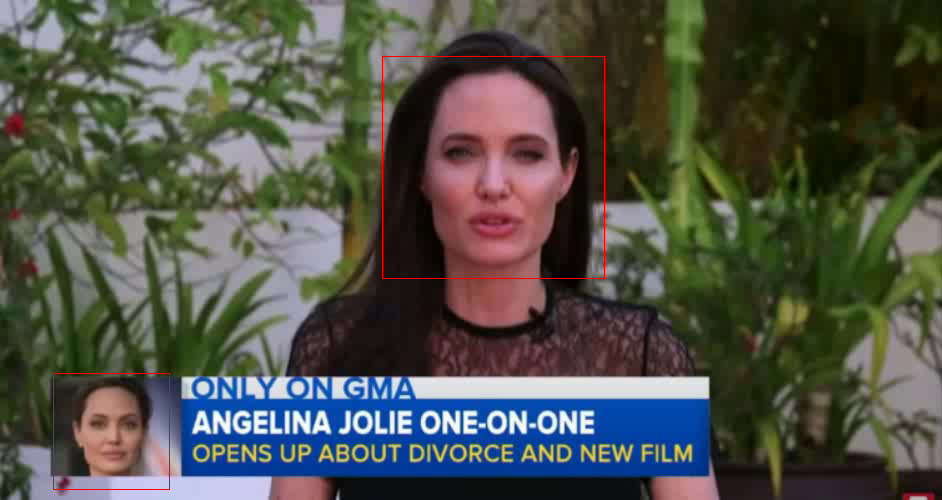

Wed Aug  2 18:12:45 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id13_0011.mp4
Wed Aug  2 18:12:48 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id13_0012.mp4
Wed Aug  2 18:12:50 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id13_0013.mp4
Wed Aug  2 18:12:52 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id13_0014.mp4
Wed Aug  2 18:12:54 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id13_0015.mp4
Wed Aug  2 18:12:57 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0000.mp4
Wed Aug  2 18:12:59 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0001.mp4
Wed Aug  2 18:13:01 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0002.mp4
Wed Aug  2 18:13:03 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0003.mp4
Wed Aug  2 18:13:05 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0004.mp4
Wed Aug  2 18:13:07 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0005.mp4
Wed Aug  2 18:13:09 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id16_0

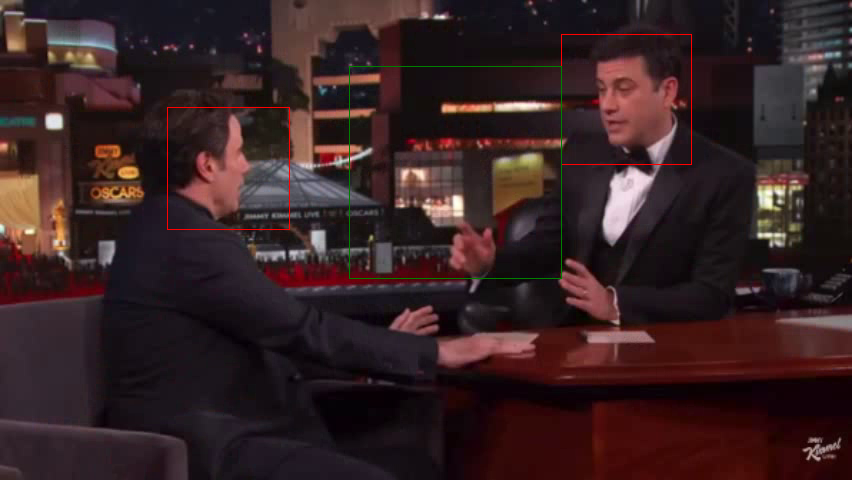

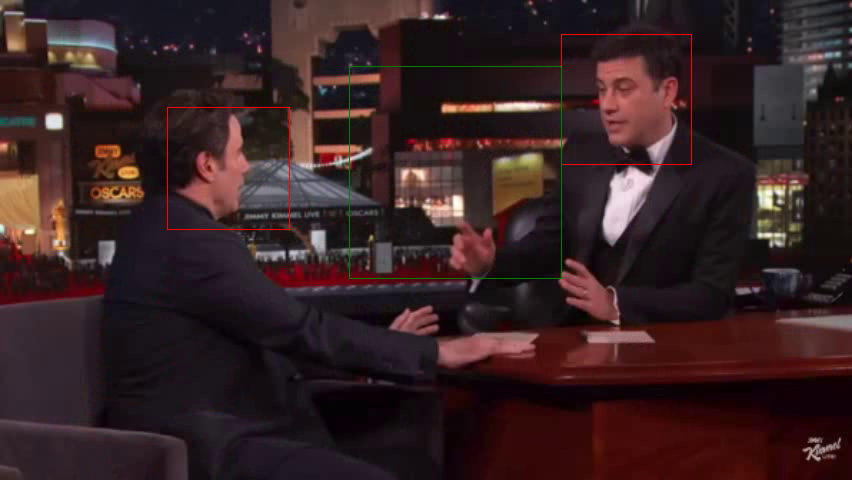

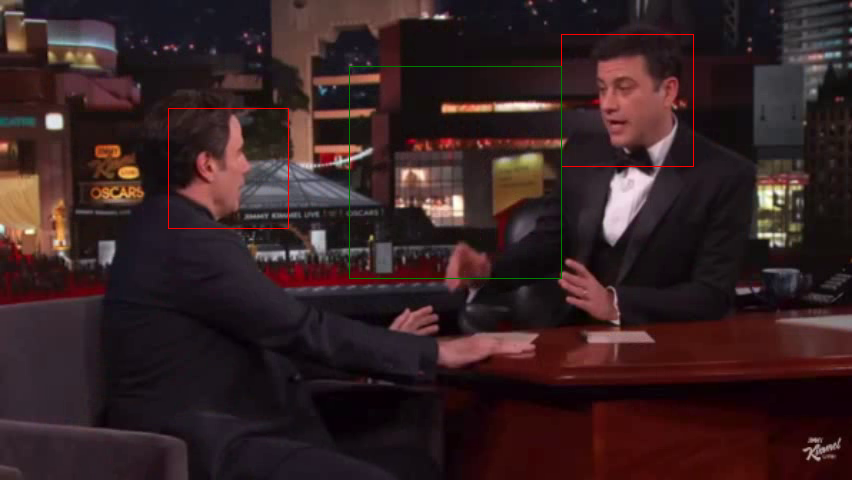

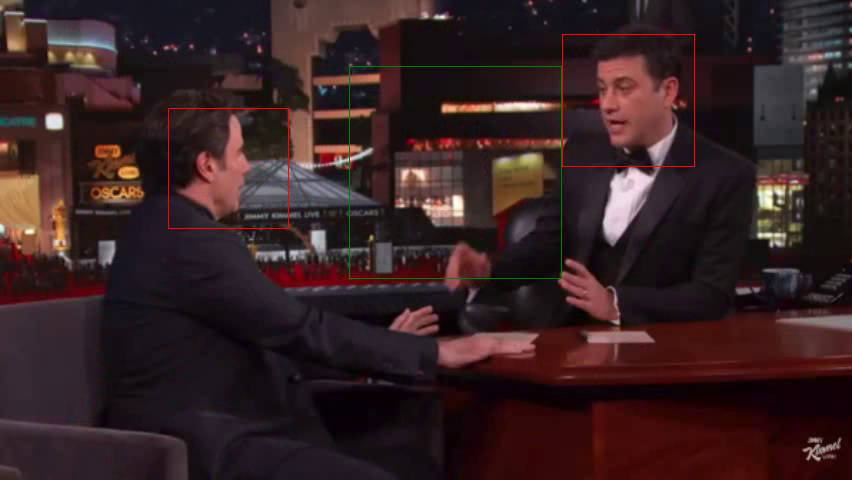

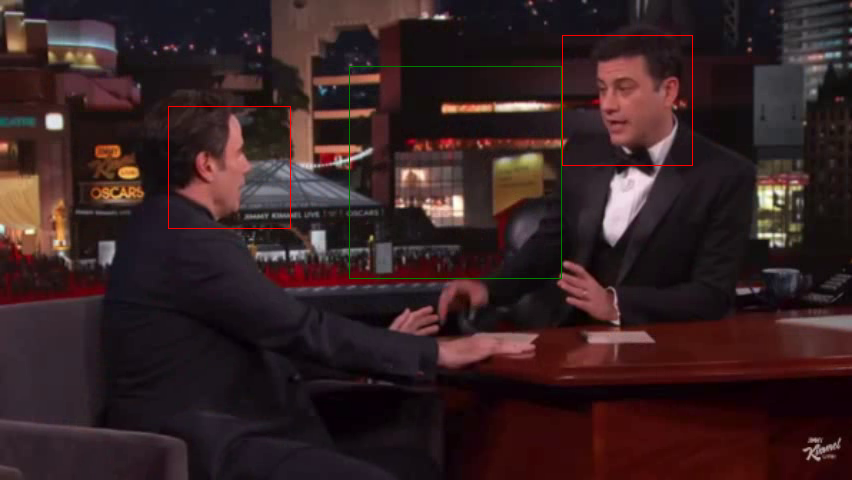

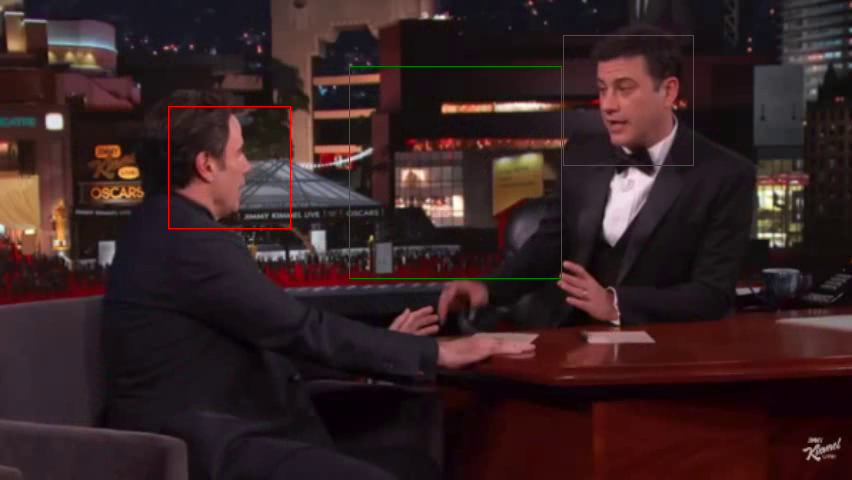

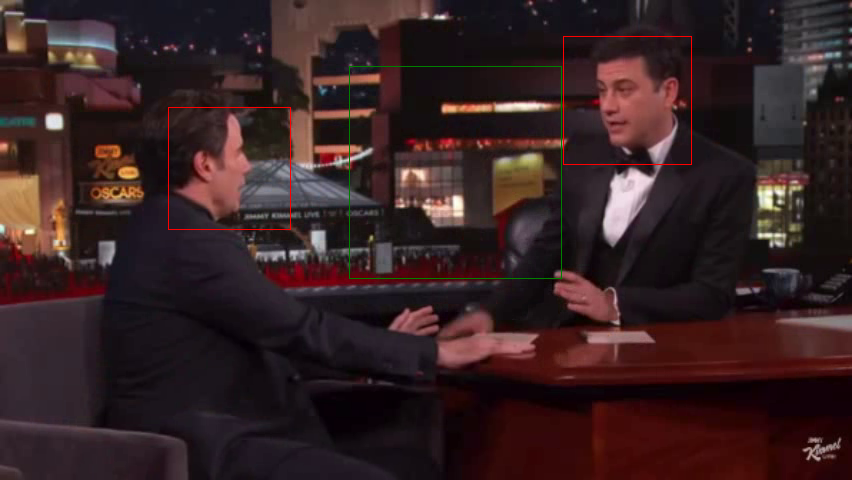

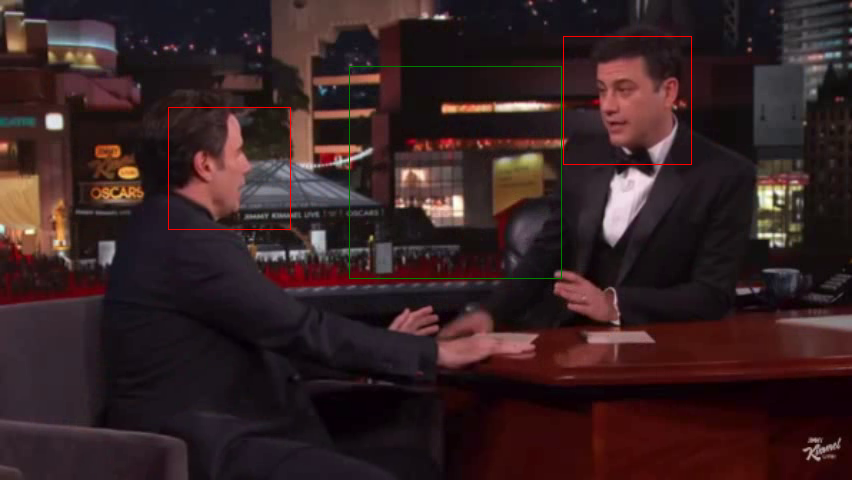

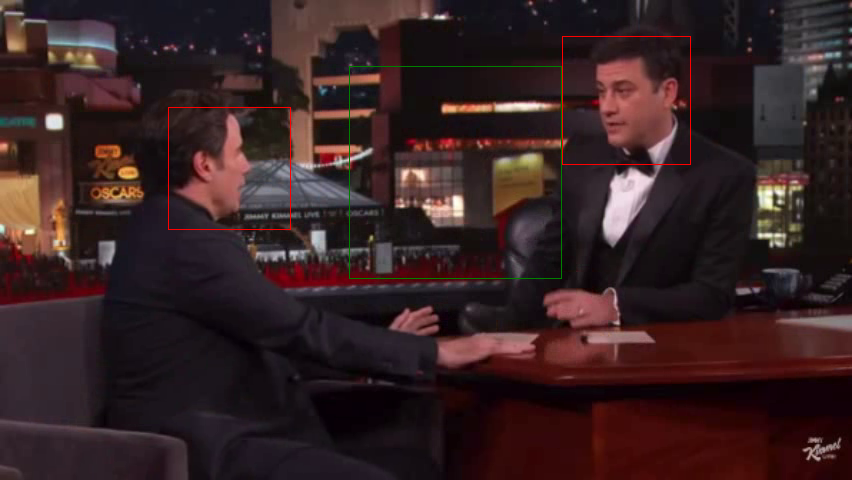

Wed Aug  2 18:14:40 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0002.mp4
Wed Aug  2 18:14:42 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0003.mp4
Wed Aug  2 18:14:43 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0004.mp4
Wed Aug  2 18:14:45 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0005.mp4
Wed Aug  2 18:14:46 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0006.mp4
Wed Aug  2 18:14:48 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0007.mp4
Wed Aug  2 18:14:50 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0008.mp4
Wed Aug  2 18:14:51 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id21_0009.mp4
Wed Aug  2 18:14:53 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id22_0000.mp4
Wed Aug  2 18:14:54 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id22_0001.mp4
Wed Aug  2 18:14:56 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id22_0002.mp4
Wed Aug  2 18:14:58 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id22_0

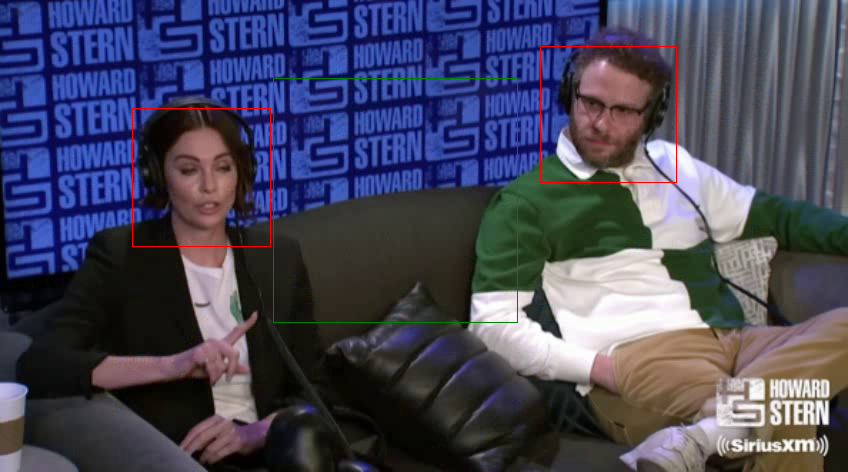

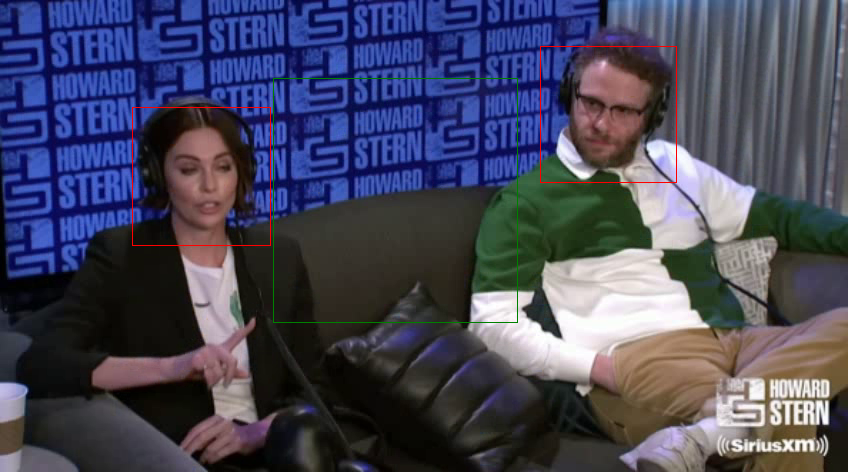

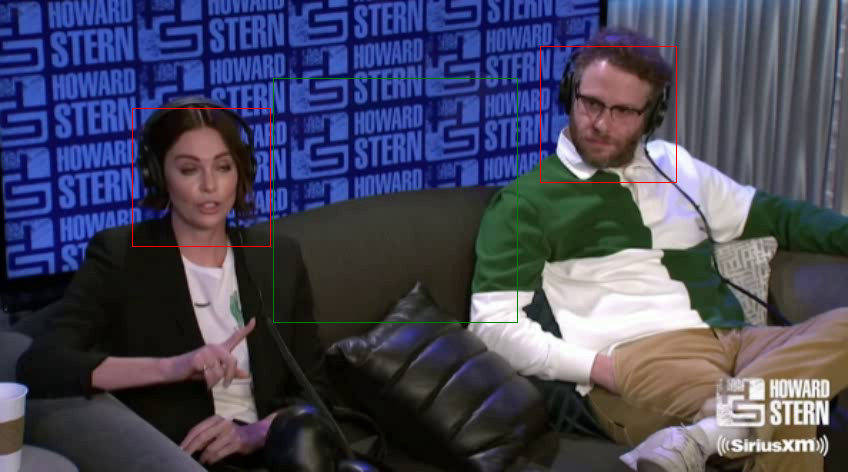

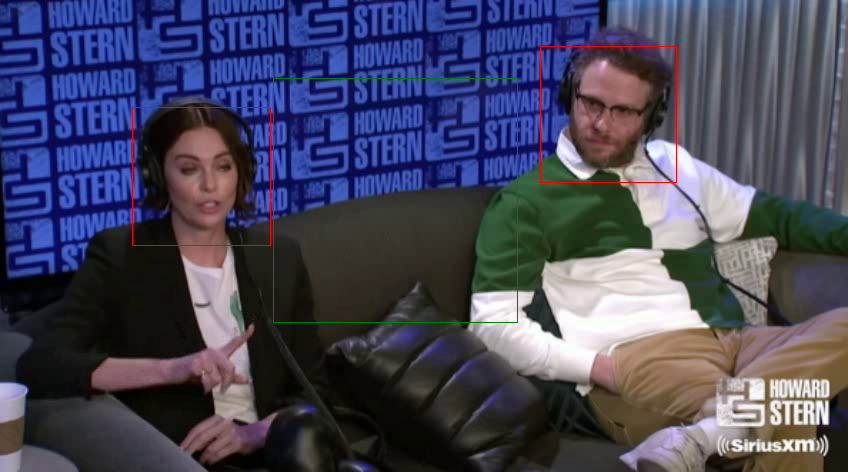

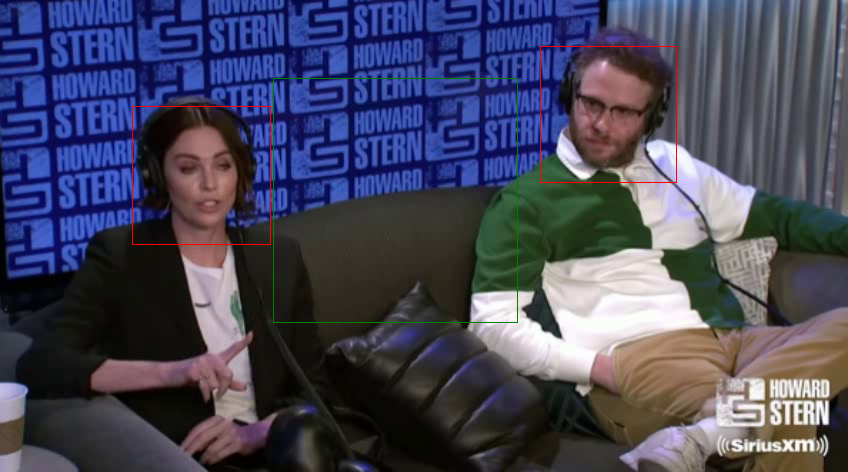

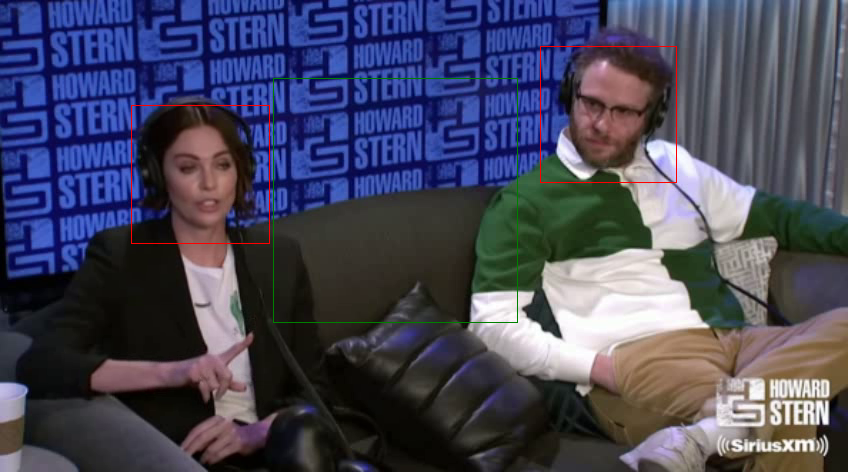

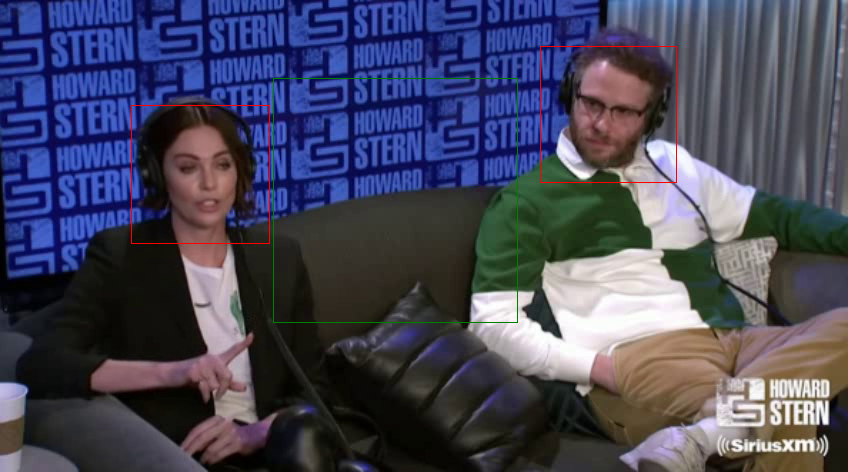

Wed Aug  2 18:22:10 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0002.mp4
Wed Aug  2 18:22:12 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0003.mp4
Wed Aug  2 18:22:14 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0004.mp4
Wed Aug  2 18:22:15 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0005.mp4
Wed Aug  2 18:22:16 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0006.mp4
Wed Aug  2 18:22:17 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0007.mp4
Wed Aug  2 18:22:19 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0008.mp4
Wed Aug  2 18:22:20 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id45_0009.mp4
Wed Aug  2 18:22:22 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id46_0000.mp4
Wed Aug  2 18:22:23 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id46_0001.mp4
Wed Aug  2 18:22:25 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id46_0002.mp4
Wed Aug  2 18:22:26 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id46_0

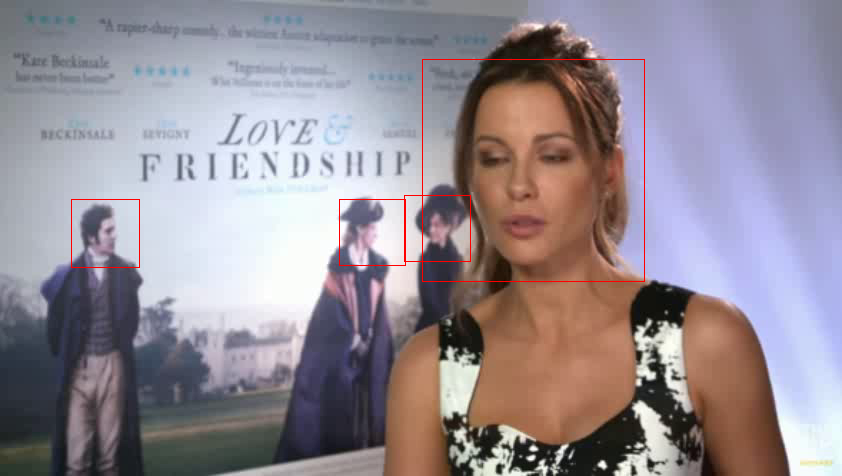

Wed Aug  2 18:22:54 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0000.mp4
Wed Aug  2 18:22:56 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0001.mp4
Wed Aug  2 18:22:57 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0002.mp4
Wed Aug  2 18:22:58 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0003.mp4
Wed Aug  2 18:23:00 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0004.mp4
Wed Aug  2 18:23:02 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0005.mp4
Wed Aug  2 18:23:04 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0006.mp4
Wed Aug  2 18:23:05 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0007.mp4
Wed Aug  2 18:23:07 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0008.mp4
Wed Aug  2 18:23:08 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id48_0009.mp4
Wed Aug  2 18:23:10 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id49_0000.mp4
Wed Aug  2 18:23:11 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id49_0

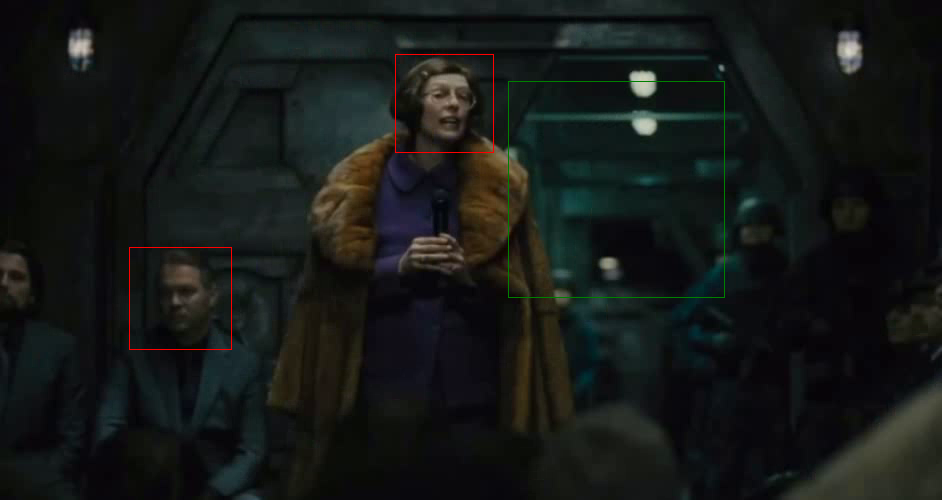

Wed Aug  2 18:23:50 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id4_0009.mp4
Wed Aug  2 18:23:52 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0000.mp4
Wed Aug  2 18:23:54 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0001.mp4
Wed Aug  2 18:23:55 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0002.mp4
Wed Aug  2 18:23:58 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0003.mp4
Wed Aug  2 18:24:00 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0004.mp4
Wed Aug  2 18:24:01 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0005.mp4
Wed Aug  2 18:24:03 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0006.mp4
Wed Aug  2 18:24:05 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0007.mp4
Wed Aug  2 18:24:07 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0008.mp4
Wed Aug  2 18:24:08 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id50_0009.mp4
Wed Aug  2 18:24:10 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id51_00

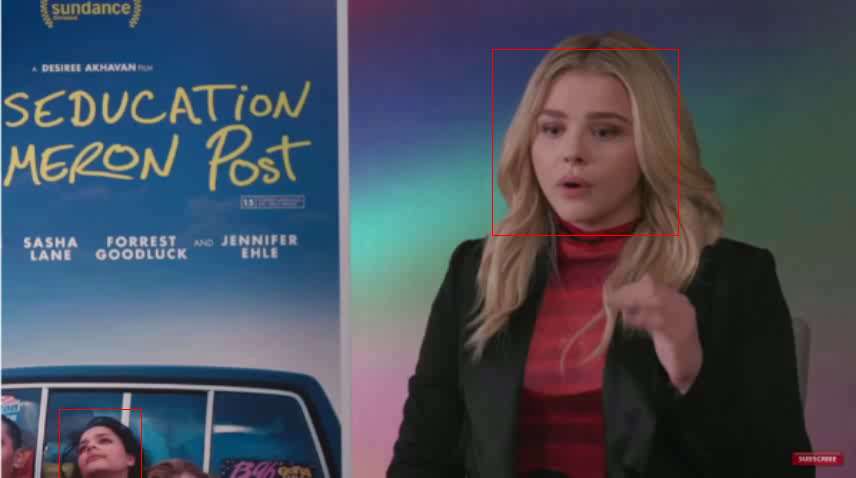

Wed Aug  2 18:25:32 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0003.mp4
Wed Aug  2 18:25:34 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0004.mp4
Wed Aug  2 18:25:36 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0005.mp4
Wed Aug  2 18:25:37 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0006.mp4
Wed Aug  2 18:25:39 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0007.mp4
Wed Aug  2 18:25:42 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0008.mp4
Wed Aug  2 18:25:43 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id55_0009.mp4
Wed Aug  2 18:25:46 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id56_0000.mp4
Wed Aug  2 18:25:48 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id56_0001.mp4
Wed Aug  2 18:25:50 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id56_0002.mp4
Wed Aug  2 18:25:52 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id56_0003.mp4
Wed Aug  2 18:25:53 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id56_0

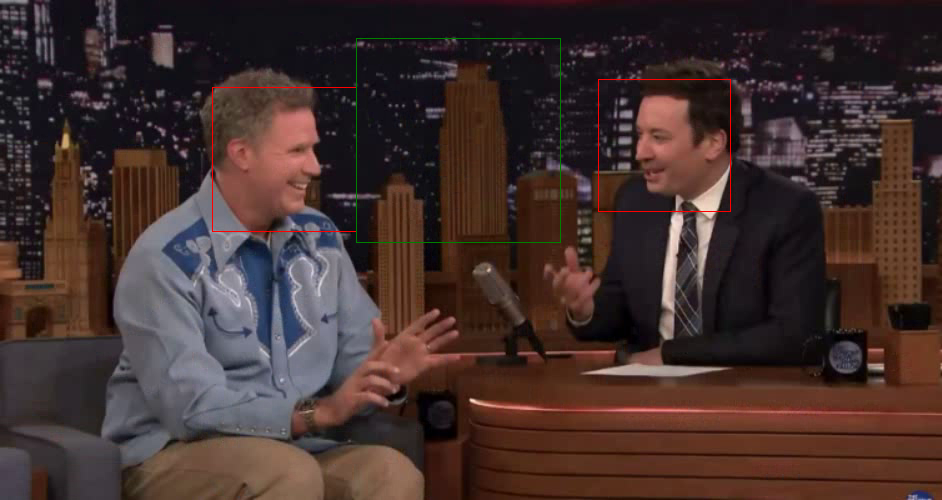

Wed Aug  2 18:28:08 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0002.mp4
Wed Aug  2 18:28:11 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0003.mp4
Wed Aug  2 18:28:14 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0004.mp4
Wed Aug  2 18:28:16 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0005.mp4
Wed Aug  2 18:28:18 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0006.mp4
Wed Aug  2 18:28:20 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0007.mp4
Wed Aug  2 18:28:23 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0008.mp4
Wed Aug  2 18:28:25 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id6_0009.mp4
Wed Aug  2 18:28:28 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id7_0000.mp4
Wed Aug  2 18:28:30 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id7_0001.mp4
Wed Aug  2 18:28:33 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id7_0002.mp4
Wed Aug  2 18:28:34 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-real/id7_0003.mp4
Wed 

In [6]:
dataDir = rootDir + 'CDF/Celeb-real/'
saveDir = rootDir + 'cropped_videos/CDF_crop/Celeb-real/'
jsonDir = rootDir + 'cropped_videos/CDF_crop/json/'
vidDirs = ls(dataDir)
savedList = ls(saveDir)
for vidDir in vidDirs:
    if vidDir in savedList:
        saved = cv2.VideoCapture(saveDir + vidDir)
        saved_frame_count = int(saved.get(cv2.CAP_PROP_FRAME_COUNT))
        saved.release()
        original = cv2.VideoCapture(dataDir + vidDir)
        original_frame_count = int(original.get(cv2.CAP_PROP_FRAME_COUNT))
        original.release()
        if saved_frame_count == original_frame_count:
            continue
    print(time.ctime(time.time()), ':', dataDir + vidDir, end='            \r')
    try:
        extract(
            detector,
            dataDir + vidDir,
            saveDir + vidDir,
            json_path=jsonDir+vidDir[:-4]+'.json',
            padding=18,
            smooth_level=5
        )
    except:
        print("\n>>>>>>>>>> ERROR OCCURED <<<<<<<<<<")

Wed Aug  2 18:35:21 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00000.mp4
Wed Aug  2 18:35:25 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00001.mp4
Wed Aug  2 18:35:27 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00002.mp4
Wed Aug  2 18:35:30 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00003.mp4
Wed Aug  2 18:35:32 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00004.mp4
Wed Aug  2 18:35:34 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00005.mp4
Wed Aug  2 18:35:37 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00006.mp4
Wed Aug  2 18:35:39 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00007.mp4
Wed Aug  2 18:35:42 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00008.mp4
 * Warning: 409 Found 2 Faces at 113


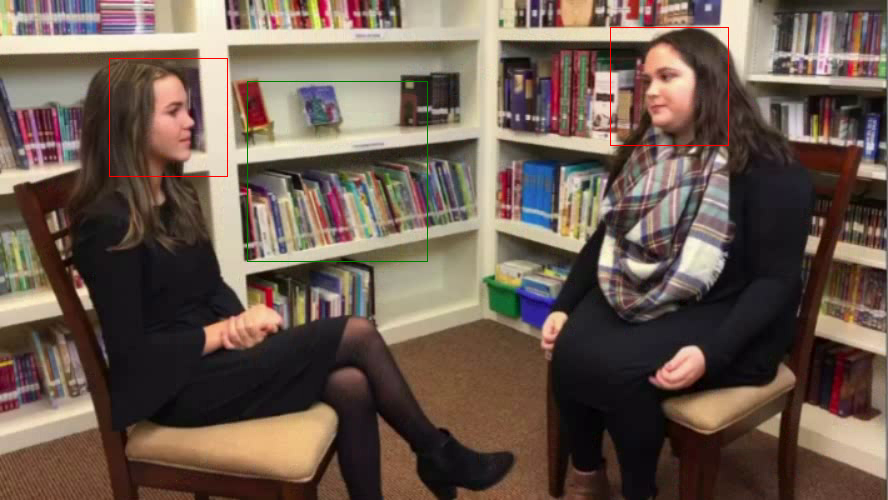

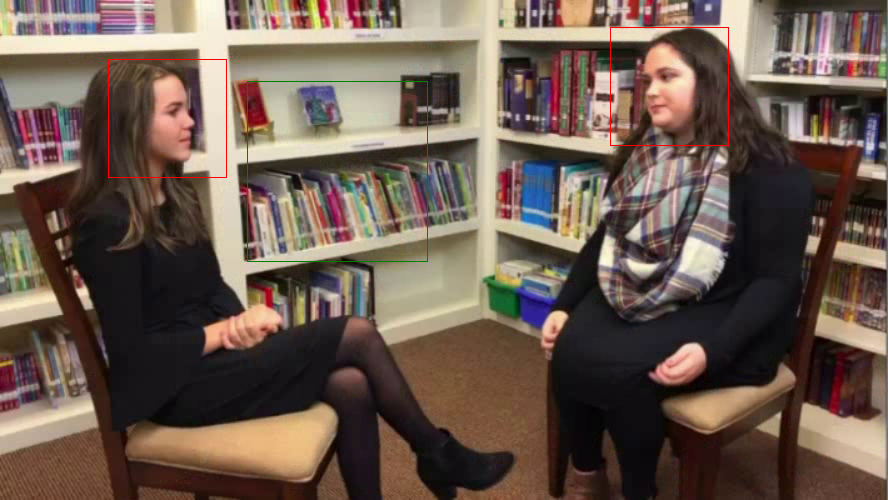

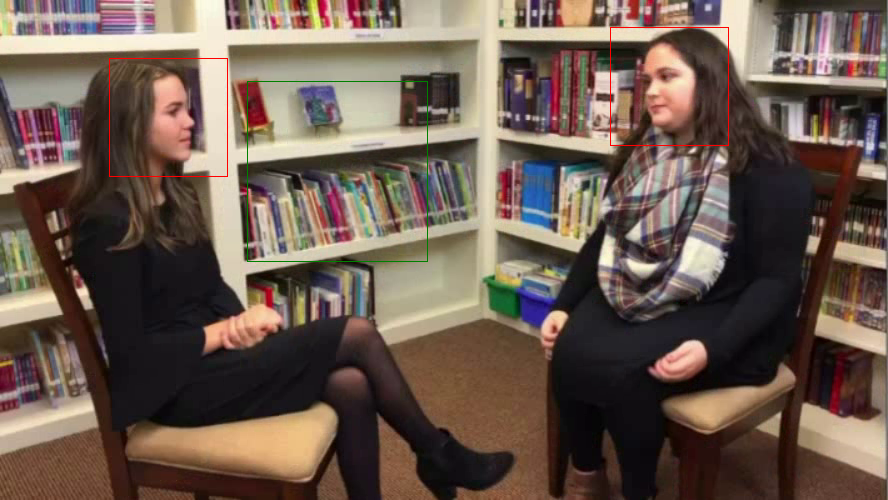

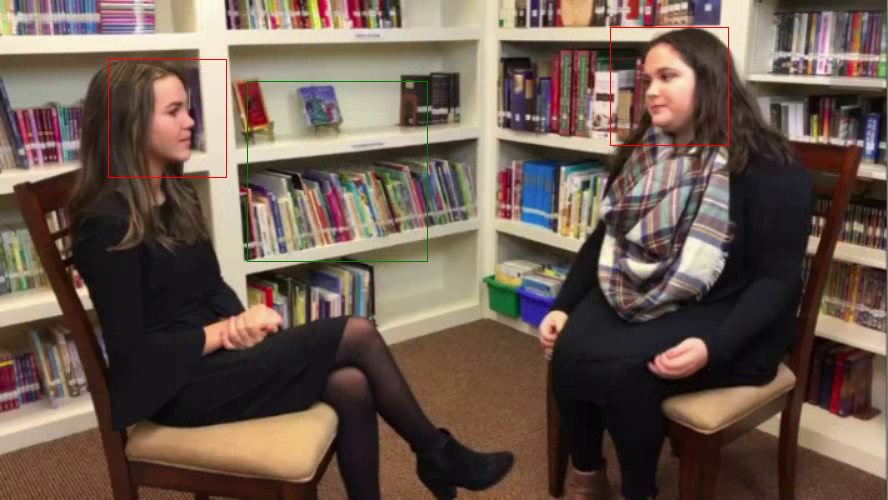

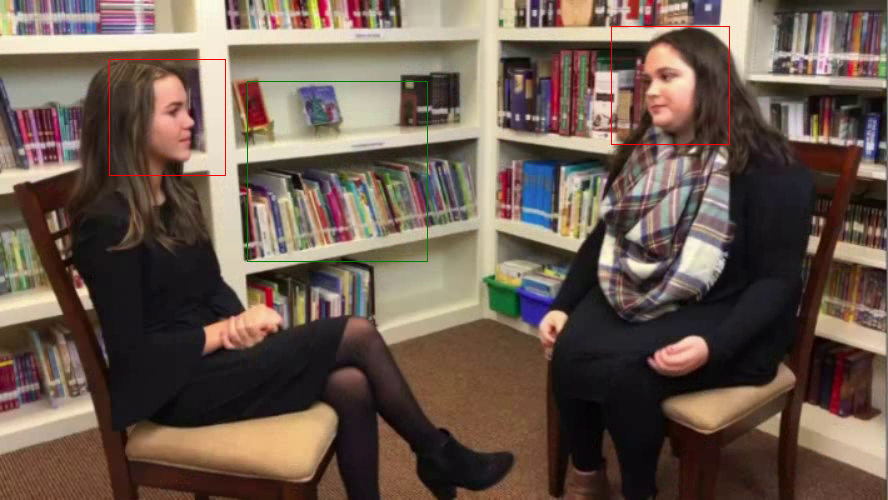

...

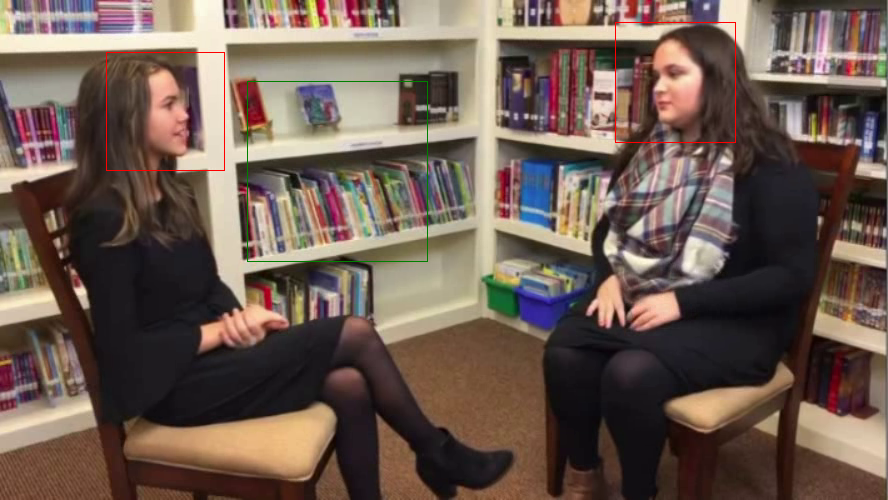

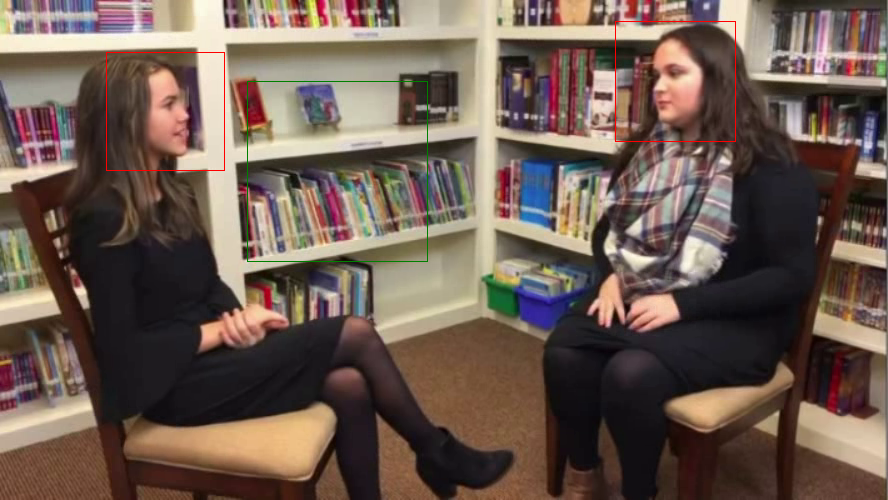

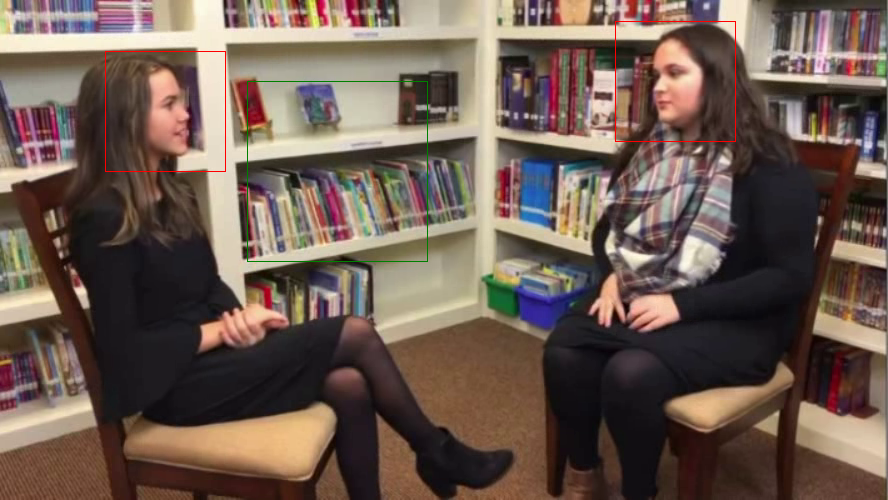

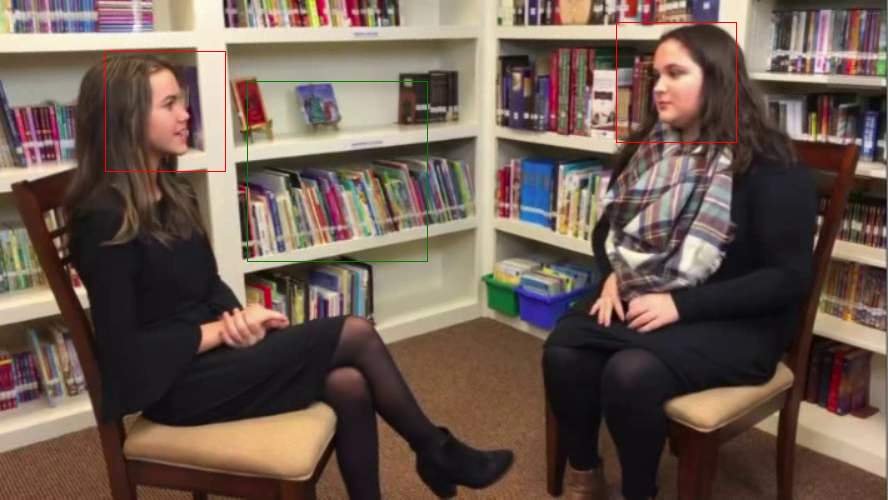

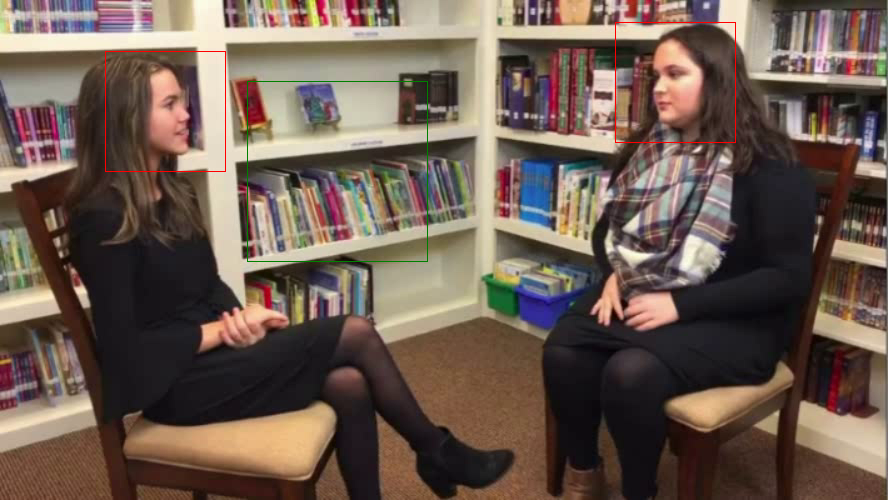

Wed Aug  2 18:35:48 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00009.mp4
Wed Aug  2 18:35:51 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00010.mp4
Wed Aug  2 18:35:53 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00011.mp4
Wed Aug  2 18:35:55 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00012.mp4
Wed Aug  2 18:35:58 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00013.mp4
Wed Aug  2 18:36:00 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00014.mp4
Wed Aug  2 18:36:03 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00015.mp4
Wed Aug  2 18:36:05 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00016.mp4
Wed Aug  2 18:36:07 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00017.mp4
Wed Aug  2 18:36:09 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00018.mp4
Wed Aug  2 18:36:11 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00019.mp4
Wed Aug  2 18:36:13 2023 : /home/kyr/GazeForensicsData/CDF/YouTube-real/00020.mp4
Wed Aug  2 18:36

In [8]:
dataDir = rootDir + 'CDF/YouTube-real/'
saveDir = rootDir + 'cropped_videos/CDF_crop/YouTube-real/'
vidDirs = ls(dataDir)
savedList = ls(saveDir)
for vidDir in vidDirs:
    if vidDir in savedList:
        saved = cv2.VideoCapture(saveDir + vidDir)
        saved_frame_count = int(saved.get(cv2.CAP_PROP_FRAME_COUNT))
        saved.release()
        original = cv2.VideoCapture(dataDir + vidDir)
        original_frame_count = int(original.get(cv2.CAP_PROP_FRAME_COUNT))
        original.release()
        if saved_frame_count == original_frame_count:
            continue
    print(time.ctime(time.time()), ':', dataDir + vidDir, end='            \r')
    try:
        extract(
            detector,
            dataDir + vidDir,
            saveDir + vidDir,
            json_path=None,
            padding=18,
            smooth_level=5
        )
    except:
        print("\n>>>>>>>>>> ERROR OCCURED <<<<<<<<<<")

In [11]:
def extract_with_json(
        detector,
        data_path,
        output_path,
        json_path
    ):
    '''
    Parameters:
        data_path: path to video file
        output_path: path to output video file
        json_path: path to the json file of bounding box data
    '''
    original_video = cv2.VideoCapture(data_path)
    frames = []
    while original_video.isOpened():
        success, frame = original_video.read()
        if not success:
            break
        frames.append(frame)
    original_video.release()

    with open(json_path, 'r') as f:
        calculated_boxes = json.load(f) # Data structure: [[x_min, y_min, x_max, y_max], ...]
    
    if len(frames) < len(calculated_boxes):
        # Delete all None in calculated_boxes
        calculated_boxes = [box for box in calculated_boxes if box is not None]

    if len(frames) != len(calculated_boxes):
        print('\n>>> Error: The number of frames and the number of bounding boxes do not match.', len(frames), len(calculated_boxes))
        extract(
            detector,
            data_path,
            output_path,
            json_path=None,
            padding=18,
            smooth_level=5,
            batch_size=400
        )
    
    # Find the max height of the bounding boxes
    max_height = 0
    for bbox in calculated_boxes:
        if bbox is None:
            continue
        height = bbox[3] - bbox[1]
        if height > max_height:
            max_height = height

    # Save the cropped frames into .mp4
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    output_size = (int(max_height / aspect_ratio), max_height)
    out = cv2.VideoWriter(output_path, fourcc, 30, output_size)
    for frame, bbox in zip(frames, calculated_boxes):
        if bbox is None:
            continue
        frame = Image.fromarray(frame).crop(bbox).resize(output_size)
        out.write(np.array(frame))
    out.release()

Before next step, move all files in 'troublesome' folder to its parent directory.

In [12]:
dataDir = rootDir + 'CDF/Celeb-synthesis/'
saveDir = rootDir + 'cropped_videos/CDF_crop/Celeb-synthesis/'
jsonsDir = rootDir + 'cropped_videos/CDF_crop/json/'
vidDirs = ls(dataDir)
savedList = ls(saveDir)
detector = RetinaFace(gpu_id=0)
for vidDir in vidDirs:
    if vidDir in savedList:
        saved = cv2.VideoCapture(saveDir + vidDir)
        saved_frame_count = int(saved.get(cv2.CAP_PROP_FRAME_COUNT))
        saved.release()
        original = cv2.VideoCapture(dataDir + vidDir)
        original_frame_count = int(original.get(cv2.CAP_PROP_FRAME_COUNT))
        original.release()
        if saved_frame_count == original_frame_count:
            continue
    print('\r' + time.ctime(time.time()), ':', dataDir + vidDir + '             ', end='')
    vidDir_elements = vidDir.split('_')
    jsonDir = vidDir_elements[0] + '_' + vidDir_elements[2][:-4] + '.json'
    try:
        extract_with_json(
            detector,
            dataDir + vidDir,
            saveDir + vidDir,
            jsonsDir + jsonDir
        )
    except:
        print("\n>>>>>>>>>> ERROR OCCURED <<<<<<<<<<")

Wed Aug  2 21:43:40 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-synthesis/id10_id11_0001.mp4             
>>> Error: The number of frames and the number of bounding boxes do not match. 105 138
Wed Aug  2 21:43:45 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-synthesis/id10_id12_0001.mp4             
>>> Error: The number of frames and the number of bounding boxes do not match. 105 138
Wed Aug  2 21:43:49 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-synthesis/id10_id13_0001.mp4             
>>> Error: The number of frames and the number of bounding boxes do not match. 105 138
Wed Aug  2 21:43:54 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-synthesis/id10_id7_0001.mp4              
>>> Error: The number of frames and the number of bounding boxes do not match. 105 138
Wed Aug  2 21:43:59 2023 : /home/kyr/GazeForensicsData/CDF/Celeb-synthesis/id11_id7_0000.mp4             
>>> Error: The number of frames and the number of bounding boxes do not match. 349 352
Wed Aug  2 21:45:17 2023 : /hom